In [1]:
import requests
import csv
from PIL import Image
from io import BytesIO
import os
import os.path
import uuid

In [2]:
# image detection imports
from torchvision.io.image import read_image

# Explore the torchvision documentation to apply the other models and their weights
from torchvision.models.detection import (
    fasterrcnn_resnet50_fpn_v2,
    FasterRCNN_ResNet50_FPN_V2_Weights,
)
from torchvision.utils import draw_bounding_boxes
from torchvision.transforms.functional import to_pil_image
from IPython.display import display

In [3]:
package_1 = "./digitized-books/sample-data/metadata.csv"
package_2 = "./ftu/sample-data/metadata.csv"
package_3 = "./full-ftu-metadata.csv"

In [4]:
with open(package_3, 'r') as metadata:
    items = metadata.read()
    print(items)
    # print(items)

Call_number,Contributors,Date_text,Date,Digitized,Set,Genre,Id,IIIF_manifest,Preview_url,Index,Description,Creators_names,Creators_roles,Type_of_resource,MODS Record,MARCXML Record,MARC Record,Dublin Core Record,Rights,Source_collection,Language,Lccn,Medium,Mime_type,Notes,Online_format,Original_format,Part_of,Repository,Number_of_files,Shelf_id,Subjects,Subject_headings,Last_updated_in_api,Title,Url,Location_text,Location_Short_name,Location_Full_name,Location_Osm_url,Location_Latitude,Location_Longitude,Location_County,Location_State_district,Location_State,Location_Country,METSXML Record,Other_title,MODSXML Record
"LOT 14043-2, no. 1060 [P&P]","Lenthall, H. (Henry), 1820-1897, photographer. | Kilburn, William Edward, 1818-1891, photographer.","[ca. 1856, printed between 1862 and 1877]",1862,True,Nurses-And-Nursing,Albumen prints--1860-1880 | Cartes de visite--1860-1880 | Portrait photographs--1850-1860,http://www.loc.gov/item/2018653939/,http://www.loc.gov/item/2018653939/manifest.j

In [5]:
def read_csv(file, encoding='utf-8'):
    with open(file, 'r', encoding=encoding) as metadata:
        data = [] #will create a list of lists
        item = csv.reader(metadata)
        for item_row_data in item:
            data.append(item_row_data)
        return data #output will be a lit of lists and data will show up in []

In [6]:
# def main():
first_test = read_csv(package_3)

#LIST EVERY ROW
for item in first_test:
    print(item) #indexing will refer to column item in every row since the rows are "pulled" from the data list
# print(first_test[2])

# if __name__ == '__main__':
#     main()

['Call_number', 'Contributors', 'Date_text', 'Date', 'Digitized', 'Set', 'Genre', 'Id', 'IIIF_manifest', 'Preview_url', 'Index', 'Description', 'Creators_names', 'Creators_roles', 'Type_of_resource', 'MODS Record', 'MARCXML Record', 'MARC Record', 'Dublin Core Record', 'Rights', 'Source_collection', 'Language', 'Lccn', 'Medium', 'Mime_type', 'Notes', 'Online_format', 'Original_format', 'Part_of', 'Repository', 'Number_of_files', 'Shelf_id', 'Subjects', 'Subject_headings', 'Last_updated_in_api', 'Title', 'Url', 'Location_text', 'Location_Short_name', 'Location_Full_name', 'Location_Osm_url', 'Location_Latitude', 'Location_Longitude', 'Location_County', 'Location_State_district', 'Location_State', 'Location_Country', 'METSXML Record', 'Other_title', 'MODSXML Record']
['LOT 14043-2, no. 1060 [P&P]', 'Lenthall, H. (Henry), 1820-1897, photographer. | Kilburn, William Edward, 1818-1891, photographer.', '[ca. 1856, printed between 1862 and 1877]', '1862', 'True', 'Nurses-And-Nursing', 'Albume

In [7]:
#PRINT ONLY THE ROW I WANT
print(first_test[2])
# print(item)

['LC-USF34- 046569-E [P&P] LOT 1548 (corresponding photographic print)', 'Delano, Jack, 1914-1997, photographer.', '1941 Oct.', '1941', 'True', 'Nurses-And-Nursing', 'Nitrate negatives', 'http://www.loc.gov/item/2017796981/', 'http://www.loc.gov/item/2017796981/manifest.json', 'https://tile.loc.gov/storage-services/service/pnp/fsa/8c29000/8c29200/8c29209v.jpg#h=1024&w=920 | https://tile.loc.gov/storage-services/service/pnp/fsa/8c29000/8c29200/8c29209t.gif#h=150&w=145 | https://tile.loc.gov/storage-services/service/pnp/fsa/8c29000/8c29200/8c29209r.jpg#h=640&w=575 | https://tile.loc.gov/storage-services/service/pnp/fsa/8c29000/8c29200/8c29209_150px.jpg#h=150&w=135', '1', '', 'Delano, Jack, 1914-1997', 'photographer', 'Still image', 'https://lccn.loc.gov/2017796981/mods', 'https://lccn.loc.gov/2017796981/marcxml', 'https://www.loc.gov/pictures/item/2017796981/marc/', 'https://lccn.loc.gov/2017796981/dc', '<p>The contents of the Library of Congress Farm Security Administration/Office of Wa

In [8]:
for heading in first_test[0]:
    print(heading)

Call_number
Contributors
Date_text
Date
Digitized
Set
Genre
Id
IIIF_manifest
Preview_url
Index
Description
Creators_names
Creators_roles
Type_of_resource
MODS Record
MARCXML Record
MARC Record
Dublin Core Record
Rights
Source_collection
Language
Lccn
Medium
Mime_type
Notes
Online_format
Original_format
Part_of
Repository
Number_of_files
Shelf_id
Subjects
Subject_headings
Last_updated_in_api
Title
Url
Location_text
Location_Short_name
Location_Full_name
Location_Osm_url
Location_Latitude
Location_Longitude
Location_County
Location_State_district
Location_State
Location_Country
METSXML Record
Other_title
MODSXML Record


In [9]:
x = first_test[0]
y = x.index('Preview_url')
print(y)


9


In [10]:
for set in first_test:
    print(set[9])

Preview_url
https://tile.loc.gov/storage-services/service/pnp/ppmsca/57100/57163v.jpg#h=1024&w=643 | https://tile.loc.gov/storage-services/service/pnp/ppmsca/57100/57163r.jpg#h=640&w=402 | https://tile.loc.gov/storage-services/service/pnp/ppmsca/57100/57163_150px.jpg#h=150&w=94
https://tile.loc.gov/storage-services/service/pnp/fsa/8c29000/8c29200/8c29209v.jpg#h=1024&w=920 | https://tile.loc.gov/storage-services/service/pnp/fsa/8c29000/8c29200/8c29209t.gif#h=150&w=145 | https://tile.loc.gov/storage-services/service/pnp/fsa/8c29000/8c29200/8c29209r.jpg#h=640&w=575 | https://tile.loc.gov/storage-services/service/pnp/fsa/8c29000/8c29200/8c29209_150px.jpg#h=150&w=135
https://tile.loc.gov/storage-services/service/pnp/anrc/01900/01981r.jpg#h=467&w=640 | https://tile.loc.gov/storage-services/service/pnp/anrc/01900/01981v.jpg#h=747&w=1024 | https://tile.loc.gov/storage-services/service/pnp/anrc/01900/01981_150px.jpg#h=109&w=150
https://tile.loc.gov/storage-services/service/pnp/cph/3g00000/3g070

In [11]:
# filter by heading
# for loop --> print out one column from each row in CSV
# No loop --> print out specific indexed row
count = 0
main_streets = []
for item in first_test:
    if 'Main' in item[5]:
        main_streets.append(item)
        count += 1
main_streets.insert(0, first_test[0])

for street in main_streets:
    print(street)

# for street in main_streets:
#     count + 1
print(count)
# for item in first_test:
#     if 'African' in item[5]:
#         print(item)

['Call_number', 'Contributors', 'Date_text', 'Date', 'Digitized', 'Set', 'Genre', 'Id', 'IIIF_manifest', 'Preview_url', 'Index', 'Description', 'Creators_names', 'Creators_roles', 'Type_of_resource', 'MODS Record', 'MARCXML Record', 'MARC Record', 'Dublin Core Record', 'Rights', 'Source_collection', 'Language', 'Lccn', 'Medium', 'Mime_type', 'Notes', 'Online_format', 'Original_format', 'Part_of', 'Repository', 'Number_of_files', 'Shelf_id', 'Subjects', 'Subject_headings', 'Last_updated_in_api', 'Title', 'Url', 'Location_text', 'Location_Short_name', 'Location_Full_name', 'Location_Osm_url', 'Location_Latitude', 'Location_Longitude', 'Location_County', 'Location_State_district', 'Location_State', 'Location_Country', 'METSXML Record', 'Other_title', 'MODSXML Record']
['STEREO U.S. GEOG FILE - Louisiana--New Orleans--Streets--Canal [item] [P&P]', 'Unknown', 'c1901.', '1901', 'True', 'Main-Streets', 'Stereographs--1900-1910 | Photographic prints--1900-1910', 'http://www.loc.gov/item/200271

In [12]:
urls_to_image = []
for set in main_streets:
    urls_to_image.append(set[9])

# for url in urls_to_image:
#     print(url)
count_all = 0
count_1 = 0

urls_of_one = []
all_urls = []
jpg_urls = []
for url in urls_to_image:
    jpg_urls.append(url.split(' | '))
    # jpg_urls.append(url.replace('|', ''))
# print(jpg_urls)

for url in jpg_urls[1:]:
    try:
        if len(url) >= 1:
            all_urls.append(url[2])
            count_all += 1
    except:
        if len(url) == 1:
            urls_of_one.append(url[0]) #without index 0, this line was adding whole list
            count_1 += 1

# for x in urls_of_one:
#     print(x)

# for y in all_urls:
#     print(y)

# print(jpg_urls[1][2])


In [13]:
print(count_all)
print(count_1)

55
1


In [14]:
# organize into csv with relevant metadata
# get requests
# integrate into Aisaiah's script
# count_everything = 0

for x in urls_of_one:
    all_urls.append(x)

# print(all_urls)
for y in all_urls:
    print(y)
#     count_everything += 1
# print(count_everything)

https://tile.loc.gov/storage-services/service/pnp/stereo/1s10000/1s12000/1s12800/1s12884r.jpg#h=333&w=640
https://tile.loc.gov/storage-services/service/pnp/stereo/1s10000/1s12000/1s12000/1s12089r.jpg#h=336&w=640
https://tile.loc.gov/image-services/iiif/service:pnp:highsm:44300:44338/full/pct:12.5/0/default.jpg#h=724&w=1086
https://tile.loc.gov/storage-services/service/pnp/mrg/01000/01066v.jpg#h=704&w=1024
https://tile.loc.gov/image-services/iiif/service:afc:afc1991021:afc1991021_45940/full/pct:12.5/0/default.jpg#h=338&w=499
https://tile.loc.gov/storage-services/service/pnp/ds/07700/07751_150px.jpg#h=150&w=121
https://tile.loc.gov/storage-services/service/pnp/fsa/8a27000/8a27900/8a27917t.gif#h=101&w=150
https://tile.loc.gov/storage-services/service/gmd/gmd412/g4124/g4124o/pm010482.gif#h=150&w=204
https://tile.loc.gov/storage-services/service/pnp/cph/3g00000/3g04000/3g04600/3g04637r.jpg#h=511&w=640
https://tile.loc.gov/storage-services/service/pnp/habshaer/md/md0000/md0014/photos/084279p

In [ ]:
# errors = 0
# working_links = []

# for url in all_urls:
#     try:
#         image_to_detect = requests.get(url)
#         print(image_to_detect)
#         working_links.append(url)
#     except:
#         print('error')
#         errors += 1
# #     print(url)
# # print(all_urls[0])
# # test = requests.get(all_urls[0])
# # print(test)
# print(errors)

In [ ]:
# for link in working_links:
#     print(link)

In [15]:
os.getcwd()

'/Users/ilaydadogan/LOC2024/lclabs-jfp24'

In [16]:
os.mkdir('ftu-mainStreet-images')

In [17]:
# images = []
for index, image in enumerate(all_urls): #what does enumerate do? index here helps to increment the file names.
        print(image)
    # try:
        image_to_detect = requests.get(image)
        # break #tried strip() method; got error
        # if image_to_detect.status_code == 200:
        
    # print(image)
        image_filename = f"ftu-mainStreet-images/image_{index + 1}.jpg"
        img_bytes_io = BytesIO(image_to_detect.content)
        converted_file = Image.open(img_bytes_io).convert('RGB').save(image_filename) #replacing last image in loop; how to stop?
        # images.append(converted_file)
    # img_bytes_io = Image.open(BytesIO(image_to_detect.content))
        # images.append(img_bytes_io)
    # for i in img_bytes_io:
    # if os.path.isfile(f'/Users/shauna-kayharrison/Desktop/LAB/starter-tests/ftu-mainStreet-images/{image}'):
    #         image=str(uuid.uuid4())
    # with Image.open(img_bytes_io) as img:
        # if open_file.mode != 'RGB':
        #     img = open_file.convert('RGB')
    # open_file.save(image_filename)

# ?
# for thing in images:
# #     # print(type(thing))
#     thing.save(image_filename) #replacing last image in loop; how to stop?

# for img in images:
#     x = read_image(img)
#     weights = FasterRCNN_ResNet50_FPN_V2_Weights.DEFAULT
#     model = fasterrcnn_resnet50_fpn_v2(weights=weights, box_score_thresh=0.9)
#     model.eval()

# # Step 2: Initialize the inference transforms
#     preprocess = weights.transforms()

# # Step 3: Apply inference preprocessing transforms
#     batch = [preprocess(x)]

# # Step 4: Use the model and visualize the prediction
#     prediction = model(batch)[0]
#     labels = [weights.meta["categories"][i] for i in prediction["labels"]]
#     box = draw_bounding_boxes(
#     x, boxes=prediction["boxes"], labels=labels, colors="red", width=4, font_size=30
# )
#     im = to_pil_image(box.detach())
# # im.show()

# # Displays the Image
#     display(im)
    # except:
    #     print('error')


https://tile.loc.gov/storage-services/service/pnp/stereo/1s10000/1s12000/1s12800/1s12884r.jpg#h=333&w=640
https://tile.loc.gov/storage-services/service/pnp/stereo/1s10000/1s12000/1s12000/1s12089r.jpg#h=336&w=640
https://tile.loc.gov/image-services/iiif/service:pnp:highsm:44300:44338/full/pct:12.5/0/default.jpg#h=724&w=1086
https://tile.loc.gov/storage-services/service/pnp/mrg/01000/01066v.jpg#h=704&w=1024
https://tile.loc.gov/image-services/iiif/service:afc:afc1991021:afc1991021_45940/full/pct:12.5/0/default.jpg#h=338&w=499
https://tile.loc.gov/storage-services/service/pnp/ds/07700/07751_150px.jpg#h=150&w=121
https://tile.loc.gov/storage-services/service/pnp/fsa/8a27000/8a27900/8a27917t.gif#h=101&w=150
https://tile.loc.gov/storage-services/service/gmd/gmd412/g4124/g4124o/pm010482.gif#h=150&w=204
https://tile.loc.gov/storage-services/service/pnp/cph/3g00000/3g04000/3g04600/3g04637r.jpg#h=511&w=640
https://tile.loc.gov/storage-services/service/pnp/habshaer/md/md0000/md0014/photos/084279p

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth" to /Users/ilaydadogan/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth
100.0%
/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


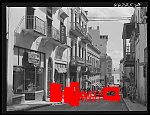

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


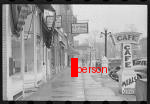

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


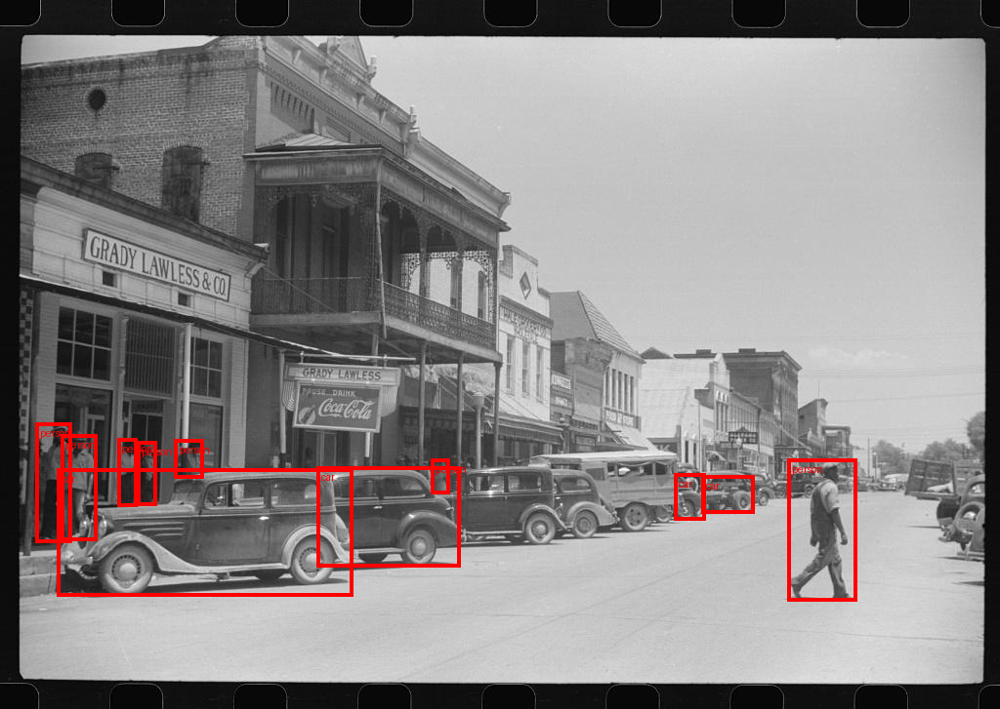

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


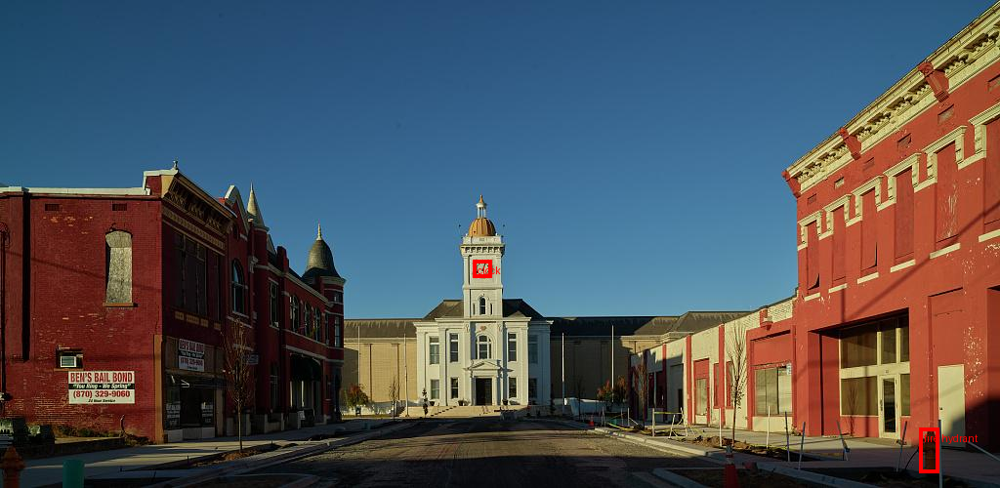

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


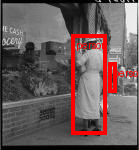

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


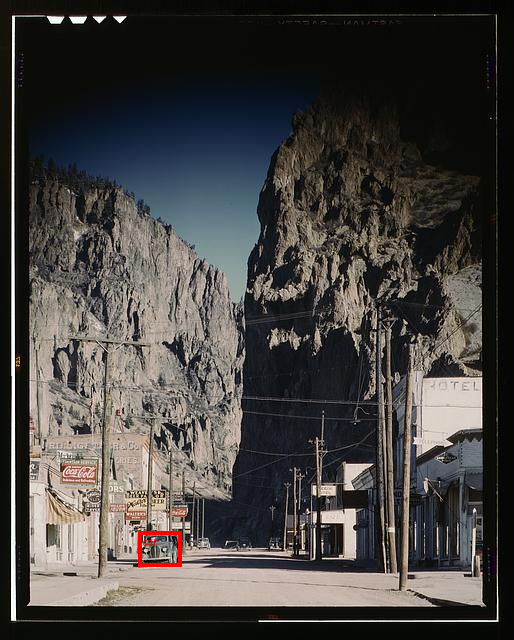

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


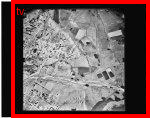

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


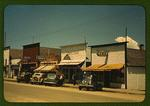

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


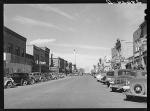

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


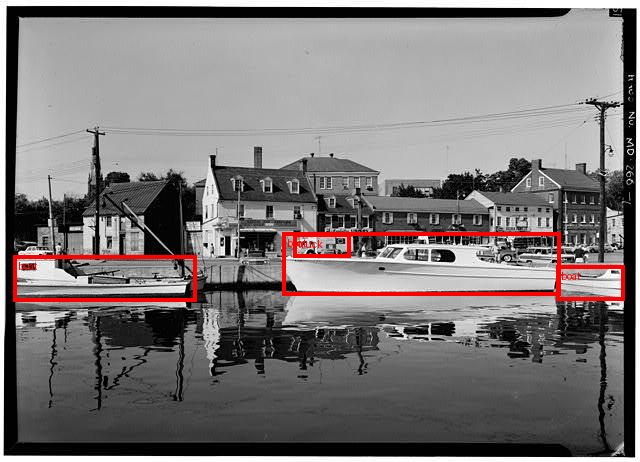

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


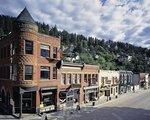

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


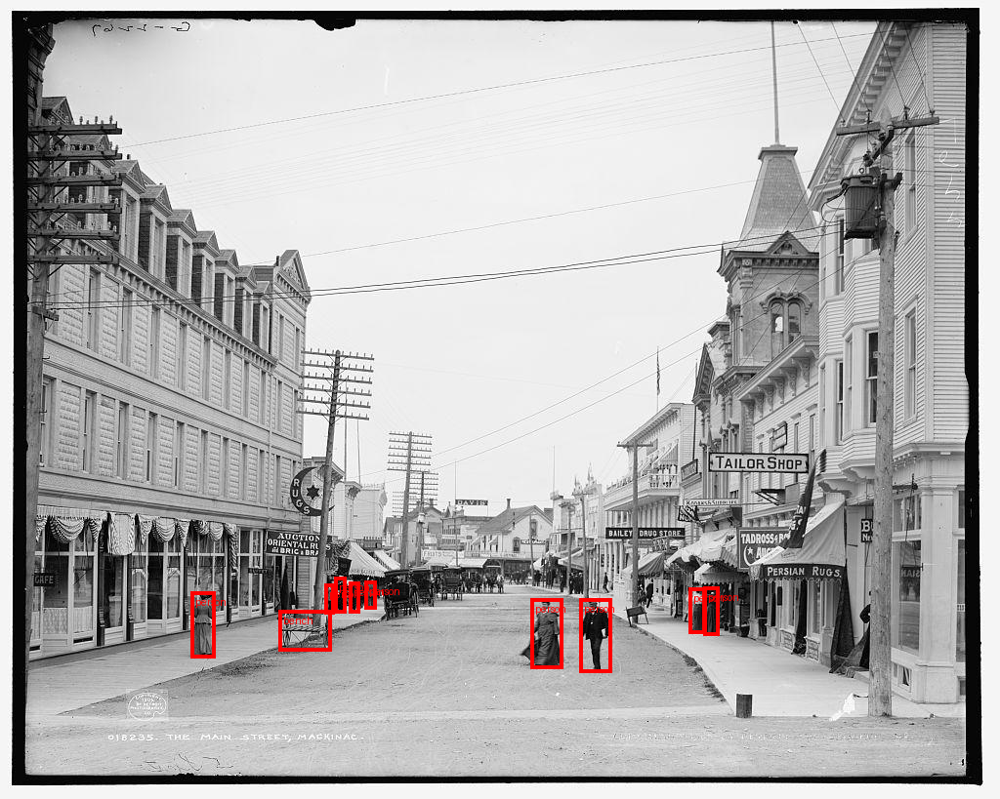

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


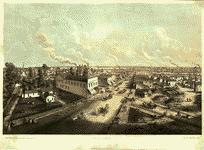

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


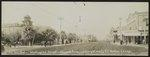

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


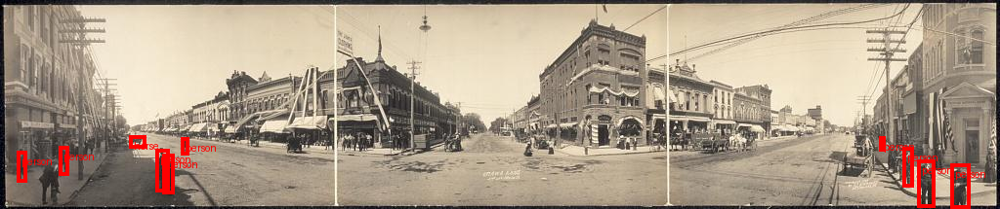

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


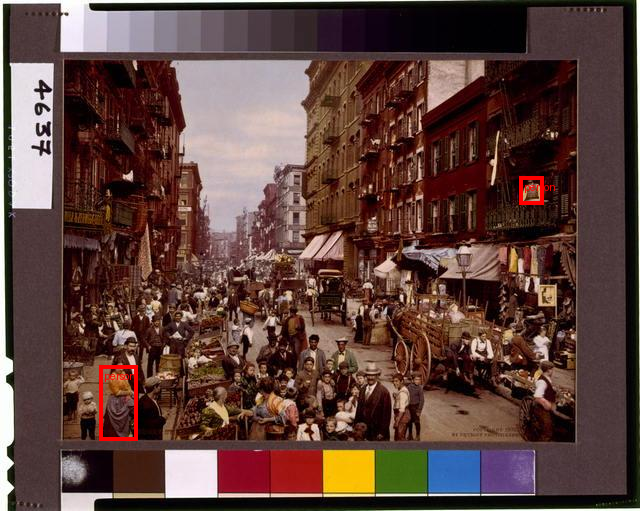

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


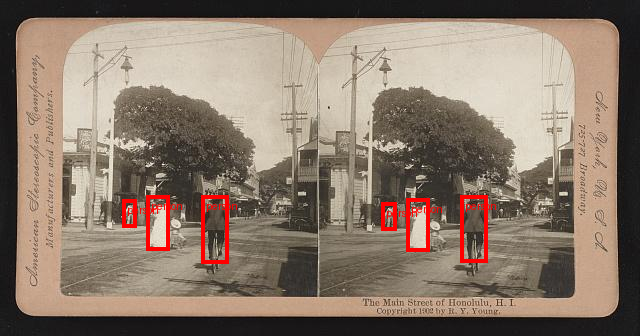

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


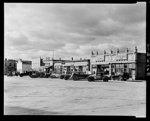

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


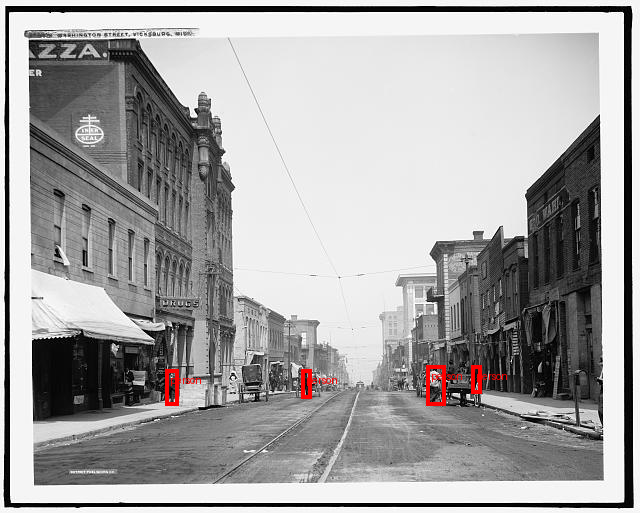

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


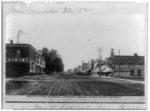

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


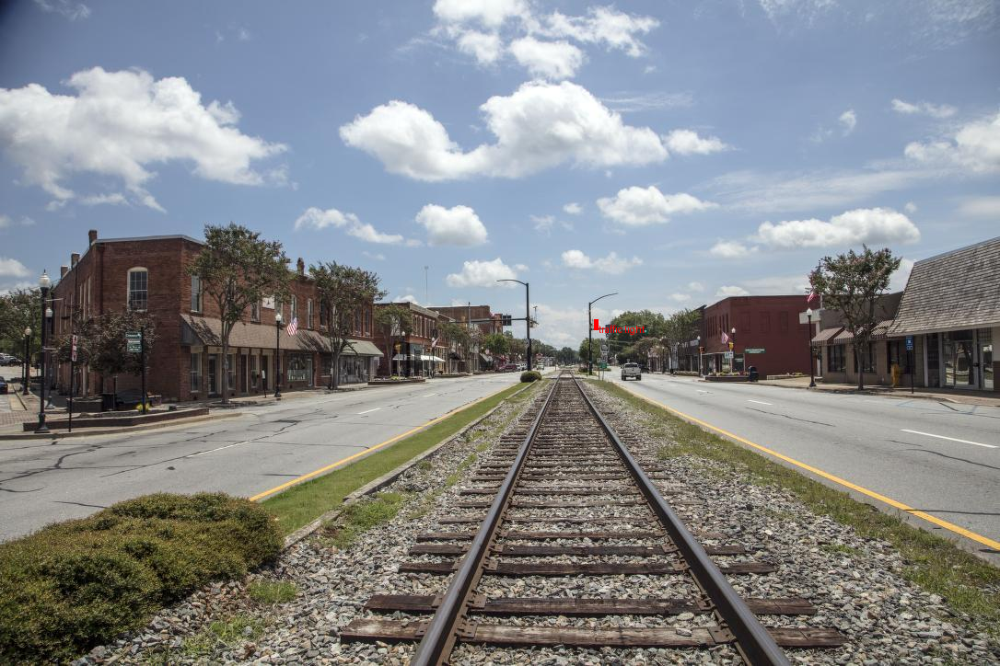

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


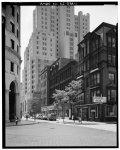

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


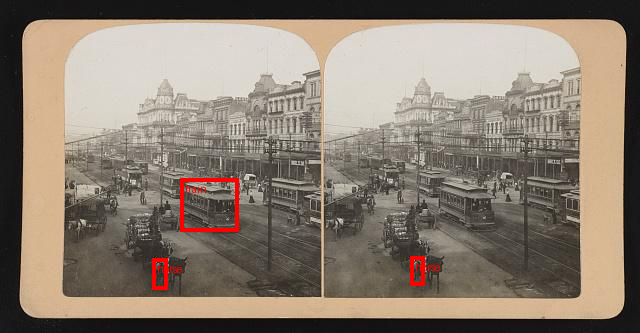

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


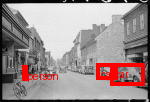

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


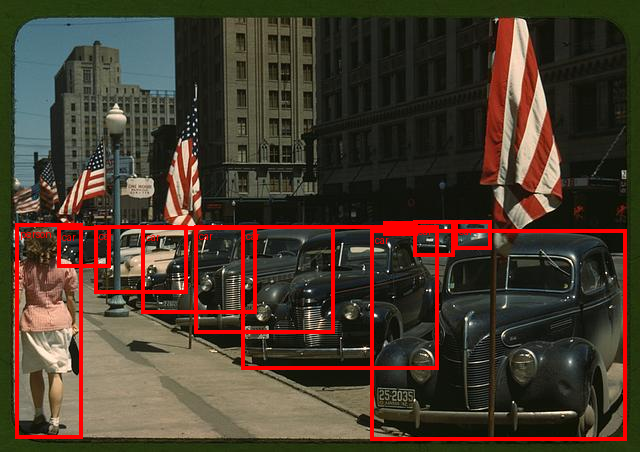

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


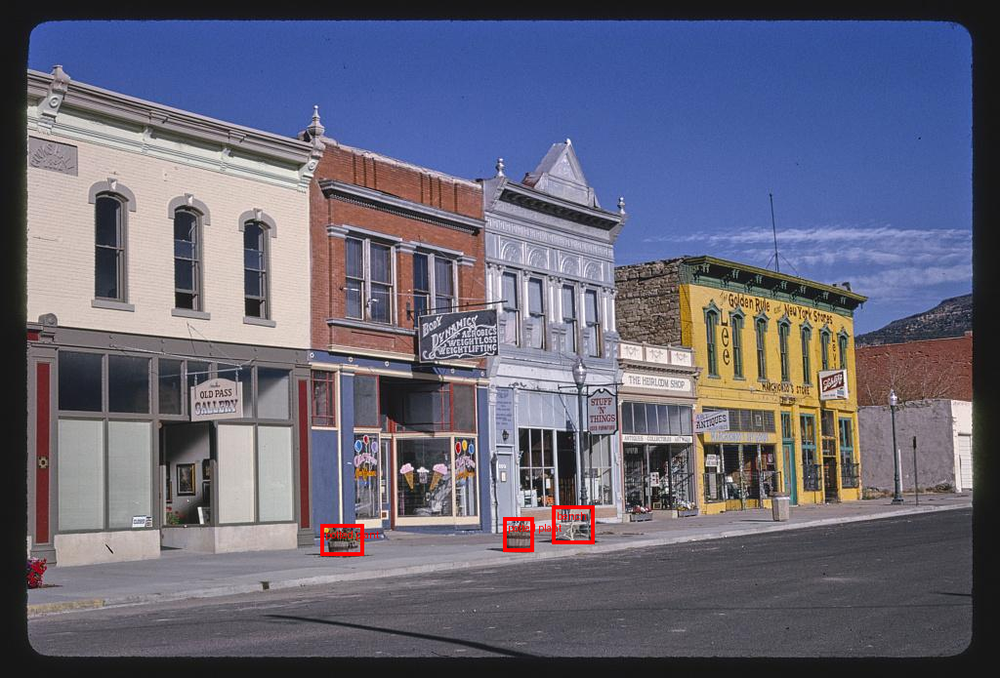

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


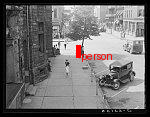

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


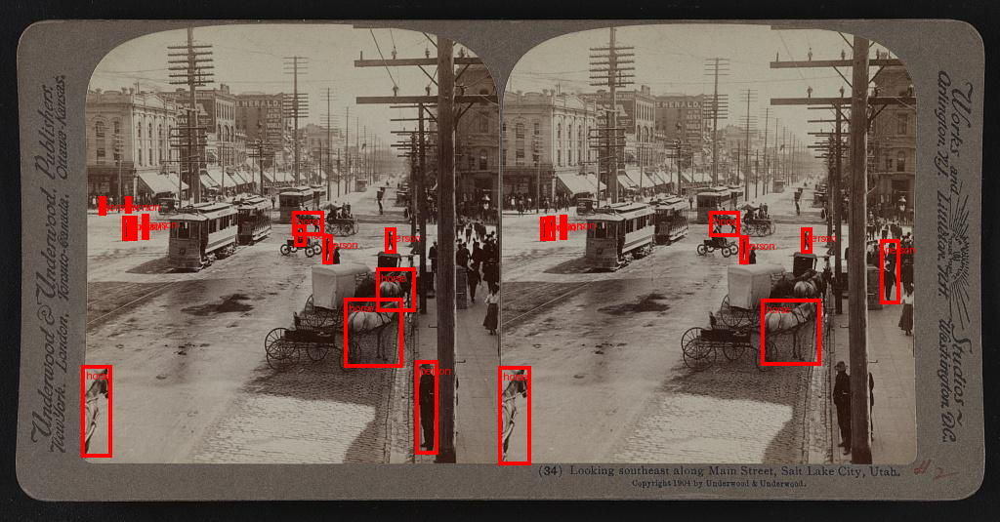

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


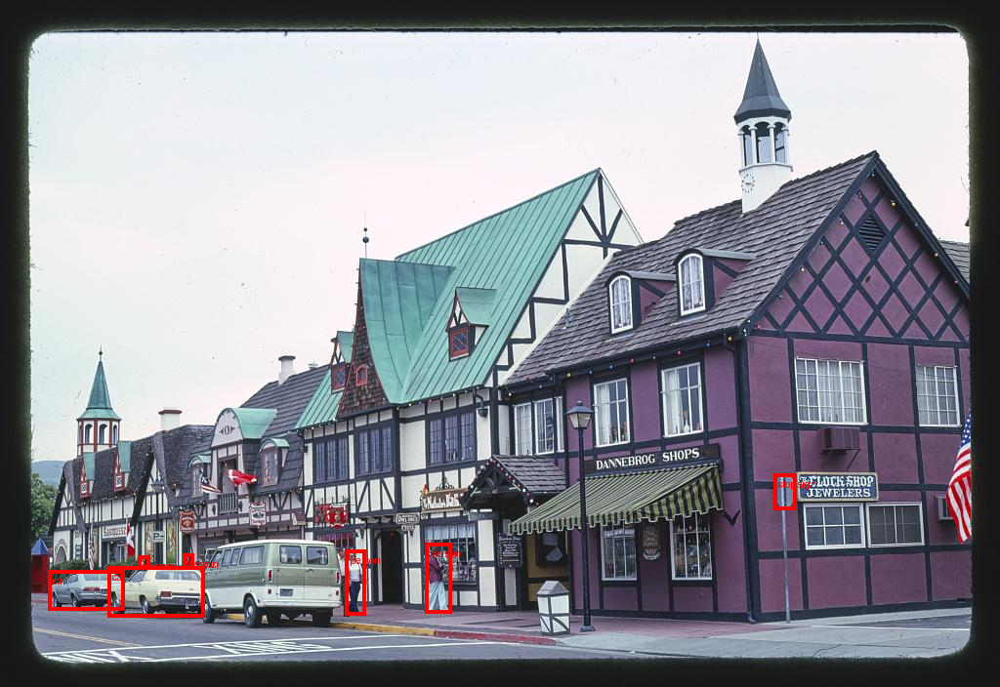

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


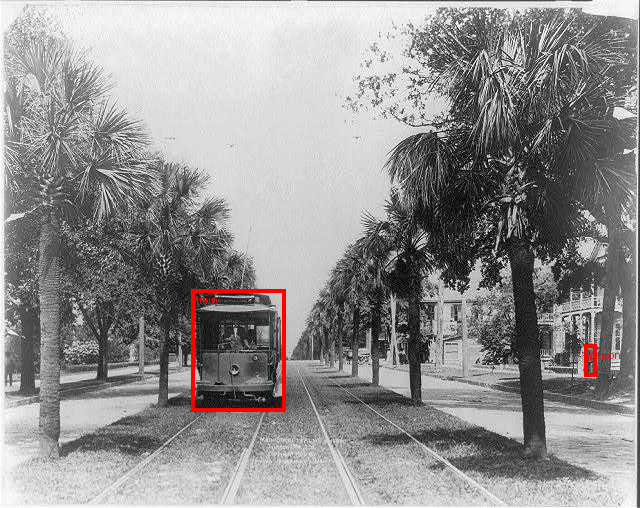

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


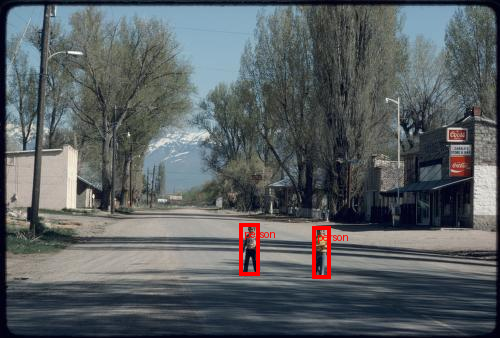

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


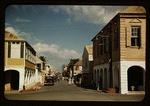

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


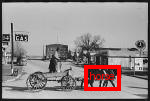

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


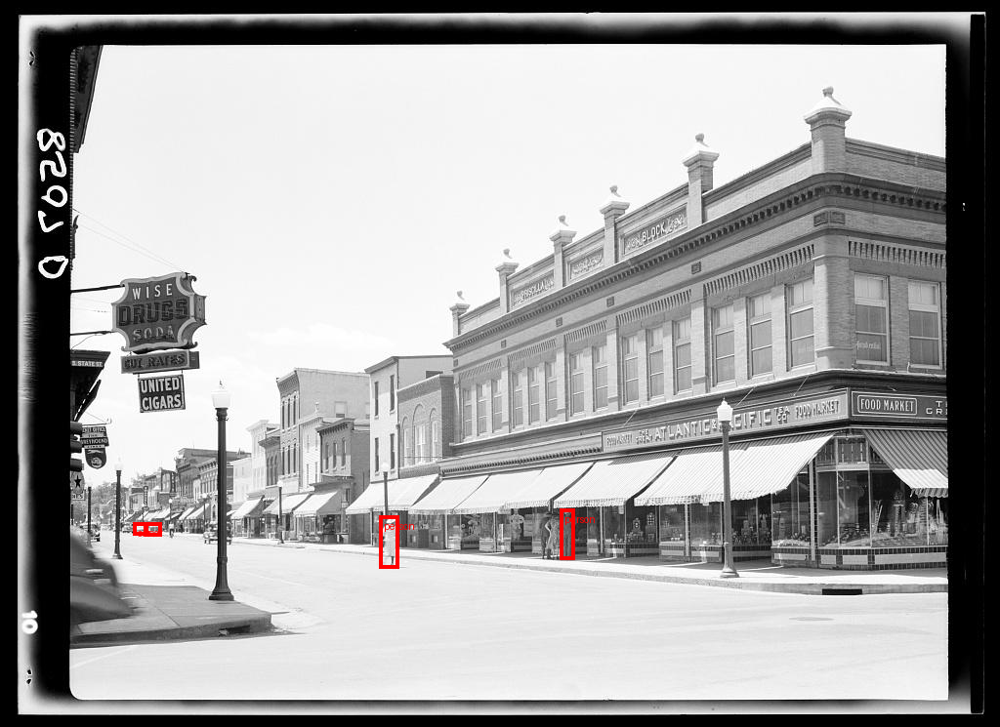

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


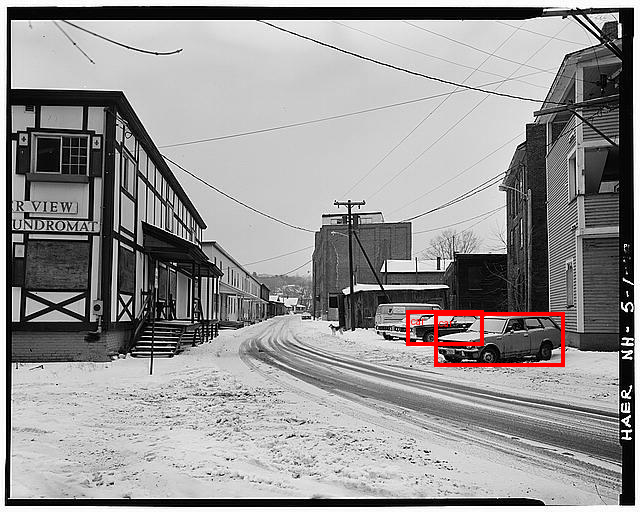

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


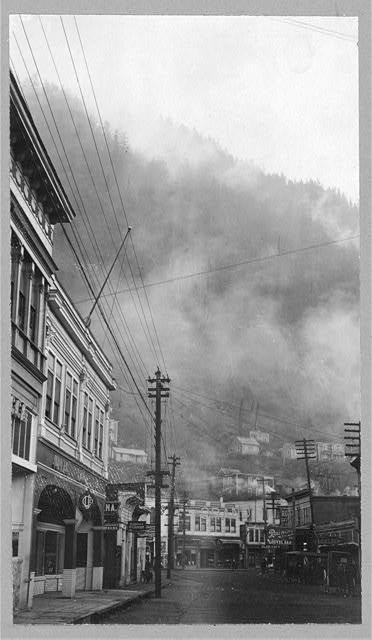

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


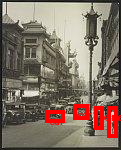

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


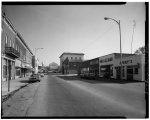

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


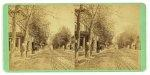

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


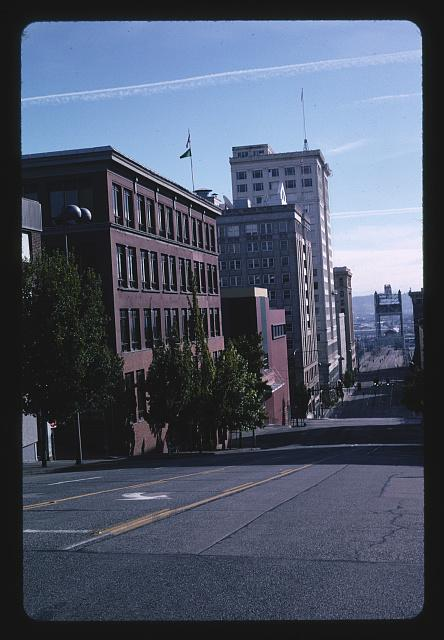

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


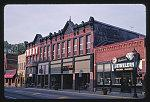

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


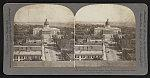

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


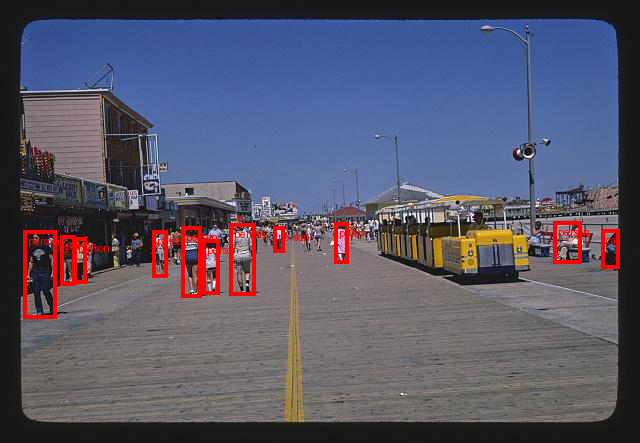

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


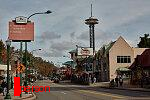

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


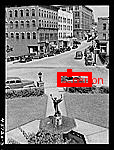

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


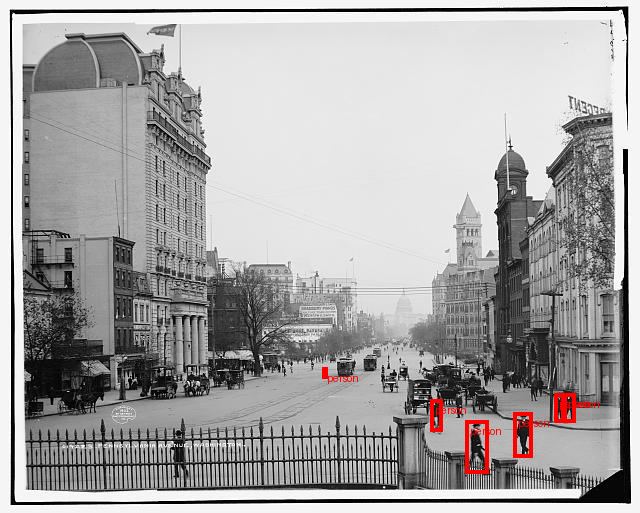

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


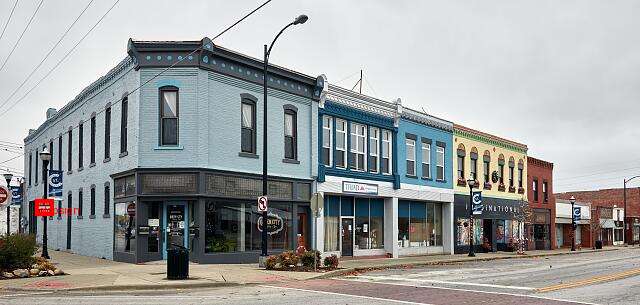

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


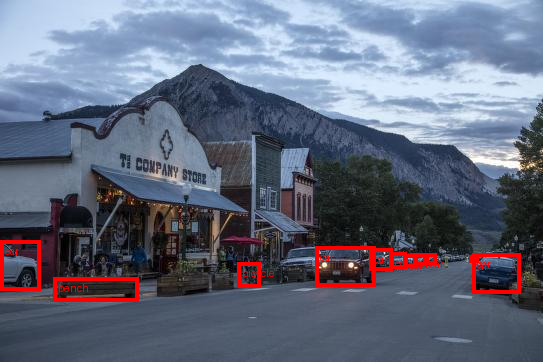

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


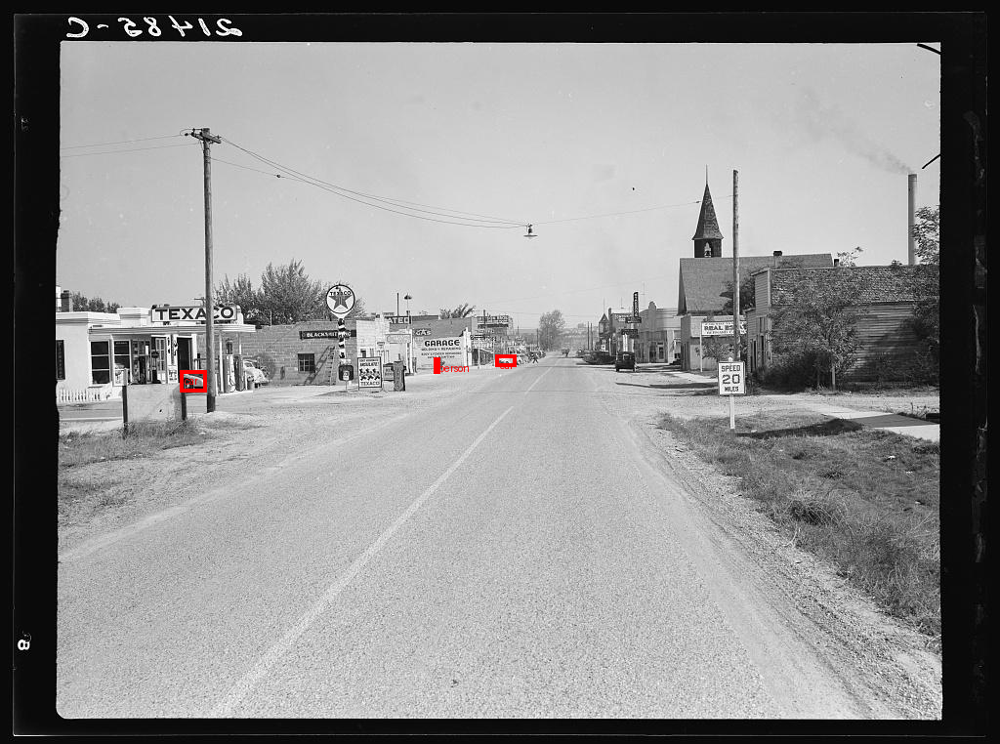

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


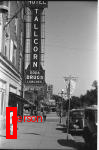

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


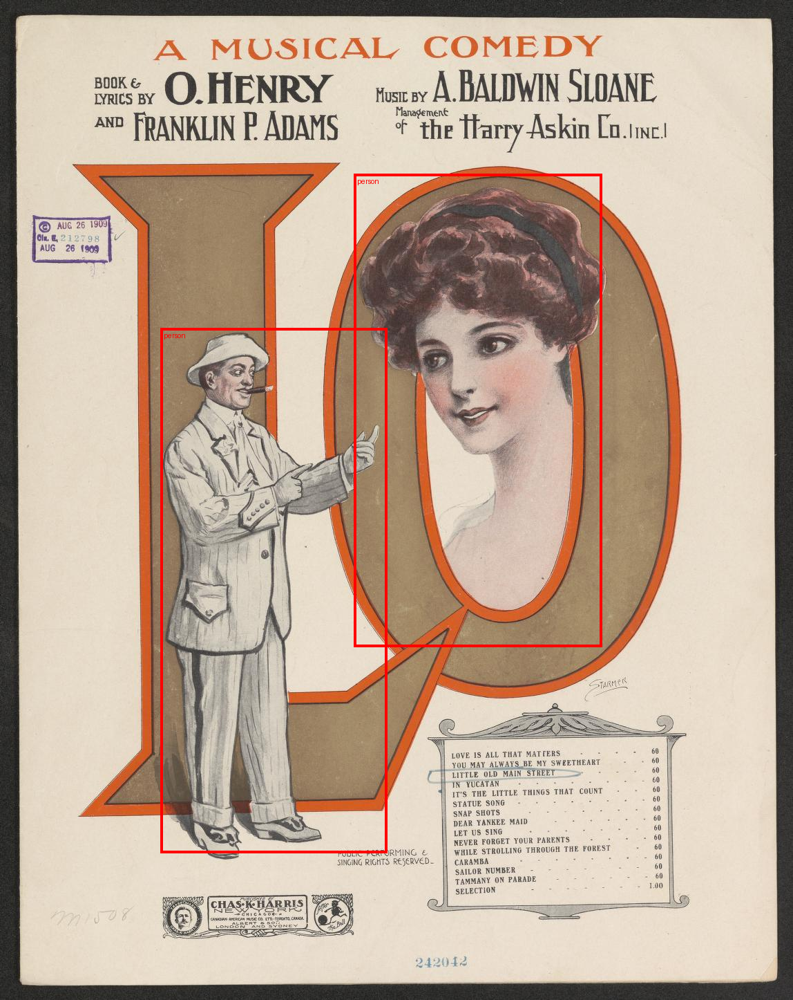

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


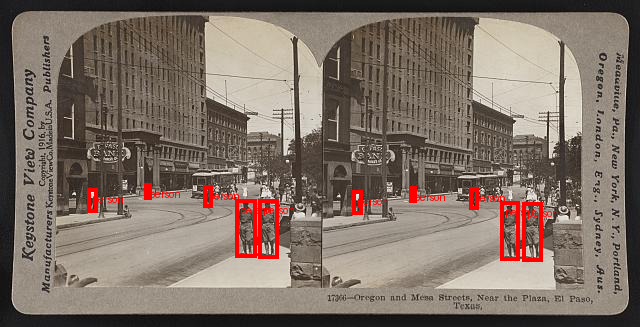

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


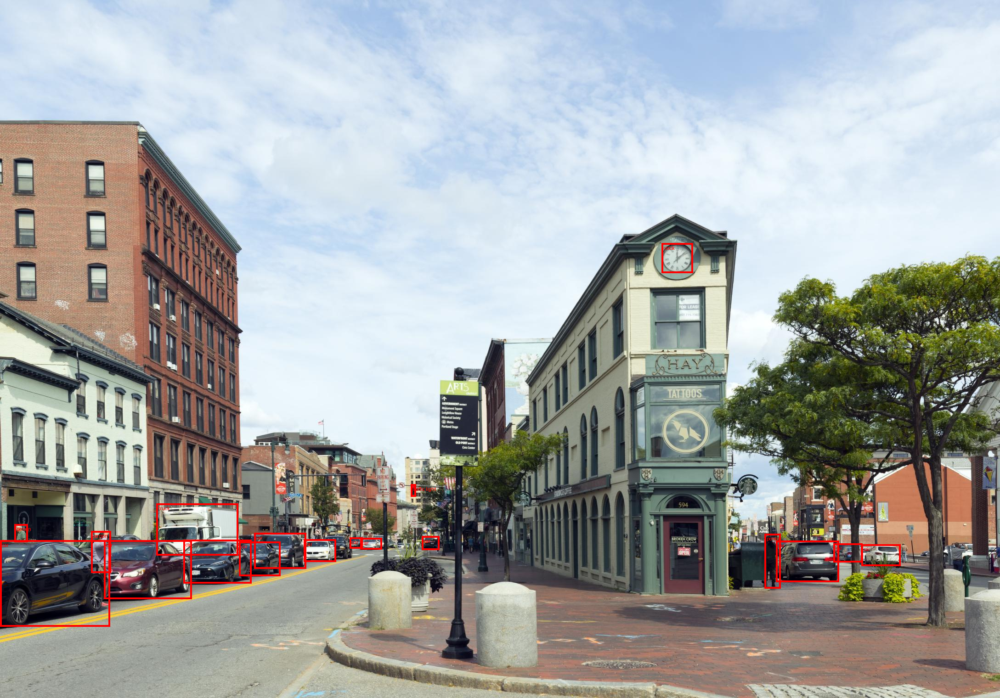

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


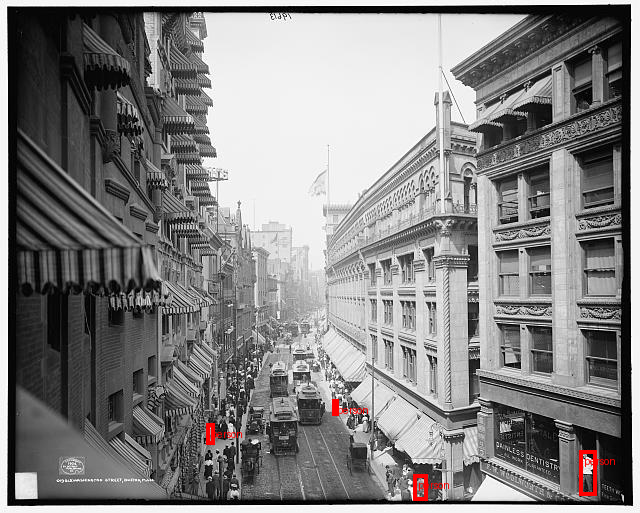

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


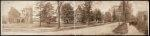

/Users/ilaydadogan/LOC2024/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


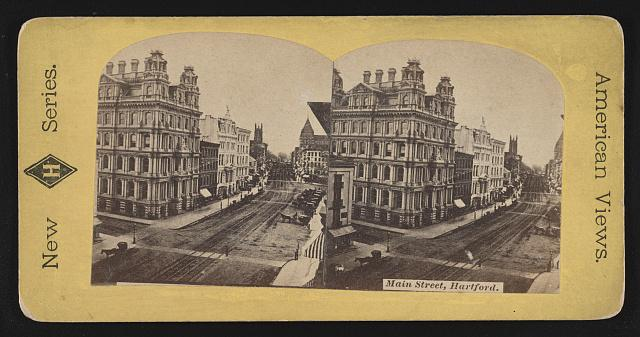

In [18]:
# iterate through directory and run model code on images
image_dir = './ftu-mainStreet-images'

for image in os.listdir(image_dir):
    f = os.path.join(image_dir, image)
    if os.path.isfile(f):
        if '.DS' not in f:
        # print(f)
            x = read_image(f)
            weights = FasterRCNN_ResNet50_FPN_V2_Weights.DEFAULT
            model = fasterrcnn_resnet50_fpn_v2(weights=weights, box_score_thresh=0.9)
            model.eval()

# # Step 2: Initialize the inference transforms
            preprocess = weights.transforms()

# # Step 3: Apply inference preprocessing transforms
            batch = [preprocess(x)]

# # Step 4: Use the model and visualize the prediction
            prediction = model(batch)[0]
            labels = [weights.meta["categories"][i] for i in prediction["labels"]]
            box = draw_bounding_boxes(
            x, boxes=prediction["boxes"], labels=labels, colors="red", width=4, font_size=30
        )
            im = to_pil_image(box.detach())
            im.show()

# # Displays the Image
            display(im)
    # except:
    #     print('error')